# Data Analysis Project: E-Commerce Public Dataset
- **Name:** Fajri Fathur Rahman
- **Email:** frstudyacc@gmail.com
- **Dicoding ID:** thurarchive

## Defining the Business Questions


###  **Question 1:** How can we segment our customers based on their purchasing behavior to target marketing efforts more effectively?


### **Question 2:** How are our customers distributed geographically, and are there any regional trends in purchasing behavior?



## Setup workspace

Import Libraries

In [2]:
import pandas as pd
import numpy as np
import folium
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans
from folium.plugins import FastMarkerCluster, Fullscreen, MiniMap, HeatMap, HeatMapWithTime, LocateControl, MarkerCluster


In [3]:
import os
os.chdir('Dataset')

In [4]:
pwd

'f:\\COURSES\\DICODING\\Belajar Analisis Data dengan Python\\E-commerce Data Analysis Project\\Dataset'

## Data Wrangling


### Gathering Data


In [5]:
cust = pd.read_csv('customers_dataset.csv')
order = pd.read_csv('orders_dataset.csv')
order_item = pd.read_csv('order_items_dataset.csv')
order_reviews = pd.read_csv('order_reviews_dataset.csv')
order_payments = pd.read_csv('order_payments_dataset.csv')
product = pd.read_csv('products_dataset.csv')
product_categories = pd.read_csv('product_category_name_translation.csv')
seller = pd.read_csv('sellers_dataset.csv')
geolocation = pd.read_csv('geolocation_dataset.csv')

### Assessing Data


In [6]:
cust.info()
cust.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [7]:
order.info()
order.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [8]:
order_item.info()
order_item.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [9]:
order_reviews.info()
order_reviews.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   review_id                99224 non-null  object
 1   order_id                 99224 non-null  object
 2   review_score             99224 non-null  int64 
 3   review_comment_title     11568 non-null  object
 4   review_comment_message   40977 non-null  object
 5   review_creation_date     99224 non-null  object
 6   review_answer_timestamp  99224 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


In [10]:
order_payments.info()
order_payments.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [11]:
seller.info()
seller.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3095 entries, 0 to 3094
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   seller_id               3095 non-null   object
 1   seller_zip_code_prefix  3095 non-null   int64 
 2   seller_city             3095 non-null   object
 3   seller_state            3095 non-null   object
dtypes: int64(1), object(3)
memory usage: 96.8+ KB


,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


In [12]:
product.info()
product.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [13]:
geolocation.info()
geolocation.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1000163 non-null  float64
 2   geolocation_lng              1000163 non-null  float64
 3   geolocation_city             1000163 non-null  object 
 4   geolocation_state            1000163 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 38.2+ MB


,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [14]:
product_categories.info()
product_categories.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   product_category_name          71 non-null     object
 1   product_category_name_english  71 non-null     object
dtypes: object(2)
memory usage: 1.2+ KB


,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


### Cleaning Data

In [15]:
print("Duplicates Order: ", order.duplicated().sum())
print("Duplicates Order Item: ", order_item.duplicated().sum())	
print("Duplicates Order Reviews: ", order_reviews.duplicated().sum())
print("Duplicates Order Payments: ", order_payments.duplicated().sum())
print("Duplicates Product: ", product.duplicated().sum())
print("Duplicates Seller: ", seller.duplicated().sum())
print("Duplicates Customer: ", cust.duplicated().sum())
print("Duplicates Product Category Name: ", product_categories.duplicated().sum())

Duplicates Order:  0
Duplicates Order Item:  0
Duplicates Order Reviews:  0
Duplicates Order Payments:  0
Duplicates Product:  0
Duplicates Seller:  0
Duplicates Customer:  0
Duplicates Product Category Name:  0


There are no duplicates unless for geolocation (there are multiple customer from same location), perhaps no need to clean the data

In [16]:
print("Missing Values Order :", order.isnull().sum())
print("Missing Values Order Item: ", order_item.isnull().sum())
print("Missing Values Product: ", product.isnull().sum())
print("Missing Values Customer: ", cust.isnull().sum())
print("Missing Values Geolocation: ", geolocation.isnull().sum())
print("Missing Values Product Category Name: ", product_categories.isnull().sum())
print("Missing Values Seller: ", seller.isnull().sum())
print("Missing Values Order Reviews: ", order_reviews.isnull().sum())
print("Missing Values Order Payments: ", order_payments.isnull().sum())

Missing Values Order : order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64
Missing Values Order Item:  order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0
dtype: int64
Missing Values Product:  product_id                      0
product_category_name         610
product_name_lenght           610
product_description_lenght    610
product_photos_qty            610
product_weight_g                2
product_length_cm               2
product_height_cm               2
product_width_cm                2
dtype: int64
Missing Values Customer:  customer_id                 0
customer_unique_id          0
customer_zip_c

#### Handling Missing Values in Orders Dataset
We dropped rows with missing values in `order_delivered_carrier_date` and `order_delivered_customer_date` as these fields are crucial for delivery time analysis. Missing values in `order_approved_at` were ignored as they are not critical for our current analysis.

In [17]:
# Handling missing values in orders dataset
order.dropna(subset=['order_delivered_carrier_date', 'order_delivered_customer_date'], inplace=True)

#### Handling Missing Values in Products Dataset
We dropped rows with missing values in `product_categories`, `product_name_lenght`, `product_description_lenght`, and `product_photos_qty` as these fields are important for product analysis.

In [18]:
# Handling missing values in products dataset
product.dropna(subset=['product_category_name', 'product_name_lenght', 'product_description_lenght', 'product_photos_qty'], inplace=True)

#### Handling Missing Values in Order Reviews Dataset
We filled missing values in `review_comment_title` and `review_comment_message` with empty strings as these fields are not critical for numerical analysis but can be useful for sentiment analysis.

In [19]:
# Handling missing values in reviews dataset
order_reviews['review_comment_title'] = order_reviews['review_comment_title'].fillna('')
order_reviews['review_comment_message'] = order_reviews['review_comment_message'].fillna('')

## Exploratory Data Analysis (EDA)

### Explore Average Purchase Amount and Yearly Sales Trends

   year  average_purchase  percentage_change
0  2016        127.204861                NaN
1  2017        120.324233          -5.409092
2  2018        119.650562          -0.559880


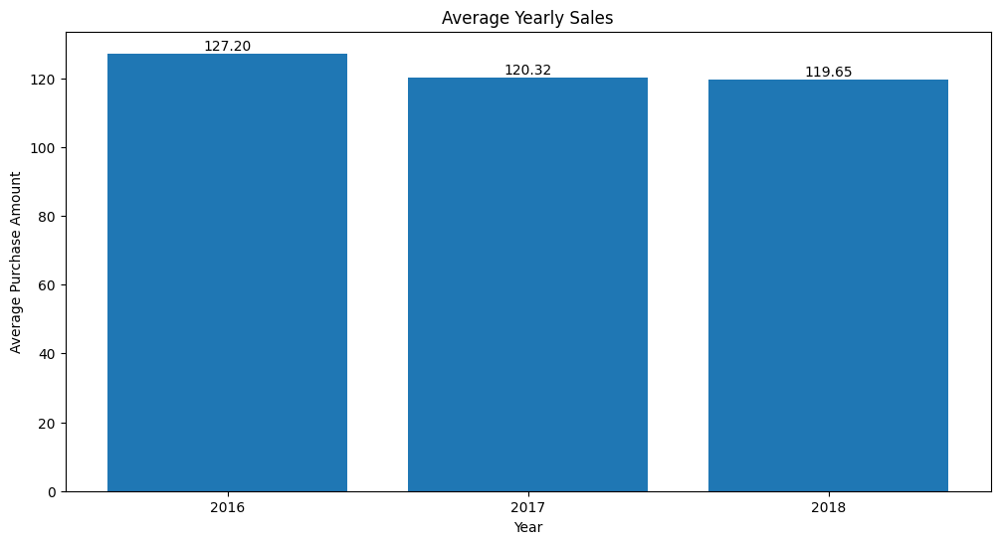

In [20]:
# Create a year column
order['order_purchase_timestamp'] = pd.to_datetime(order['order_purchase_timestamp'])
order['year'] = order['order_purchase_timestamp'].dt.year

# Calculate the average purchase amount per year
yearly_avg = order.merge(order_item, on='order_id', how='left').groupby('year')['price'].mean().reset_index()
yearly_avg.columns = ['year', 'average_purchase']

# Calculate the percentage change year over year
yearly_avg['percentage_change'] = yearly_avg['average_purchase'].pct_change() * 100

# Display the result
print(yearly_avg)

# Create a bar chart of average yearly sales
plt.figure(figsize=(12, 6))
plt.bar(yearly_avg['year'], yearly_avg['average_purchase'])
plt.title('Average Yearly Sales')
plt.xlabel('Year')
plt.ylabel('Average Purchase Amount')
plt.xticks(yearly_avg['year'])
for i, v in enumerate(yearly_avg['average_purchase']):
    plt.text(yearly_avg['year'][i], v, f'{v:.2f}', ha='center', va='bottom')
plt.show()

### Explore Customer segment

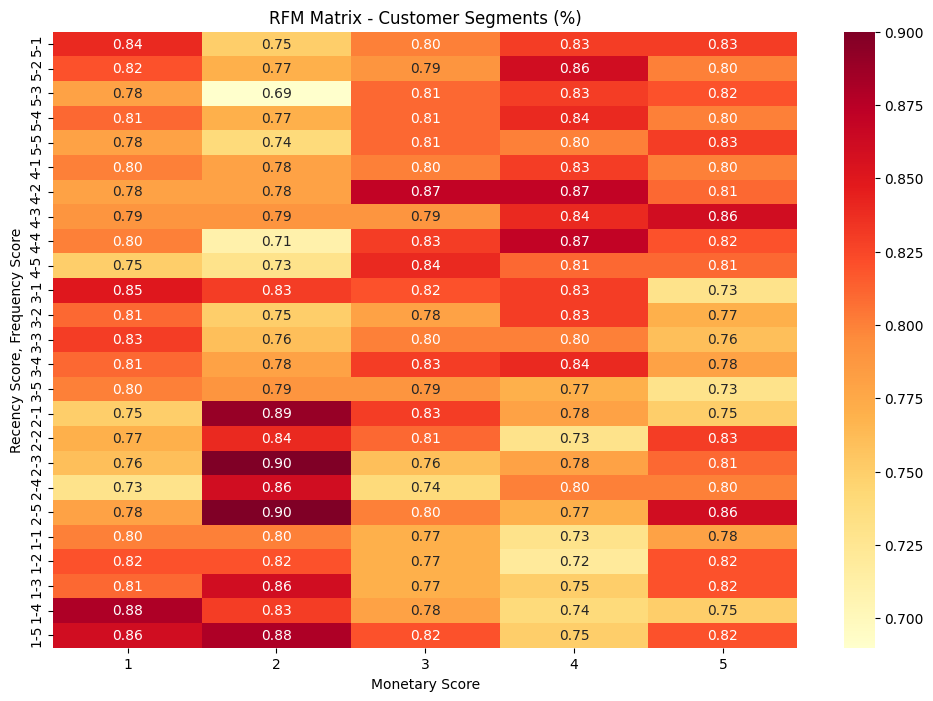

RFM Matrix (% of customers in each segment):
monetary_score                    1     2     3     4     5
recency_score frequency_score                              
5             1                0.84  0.75  0.80  0.83  0.83
              2                0.82  0.77  0.79  0.86  0.80
              3                0.78  0.69  0.81  0.83  0.82
              4                0.81  0.77  0.81  0.84  0.80
              5                0.78  0.74  0.81  0.80  0.83
4             1                0.80  0.78  0.80  0.83  0.80
              2                0.78  0.78  0.87  0.87  0.81
              3                0.79  0.79  0.79  0.84  0.86
              4                0.80  0.71  0.83  0.87  0.82
              5                0.75  0.73  0.84  0.81  0.81
3             1                0.85  0.83  0.82  0.83  0.73
              2                0.81  0.75  0.78  0.83  0.77
              3                0.83  0.76  0.80  0.80  0.76
              4                0.81  0.78  0.83  0.84  

In [21]:
order['order_purchase_timestamp'] = pd.to_datetime(order['order_purchase_timestamp'])
latest_date = order['order_purchase_timestamp'].max()

#Calculate RFM Metrics
rfm_df = order.merge(order_payments, on='order_id', how='left').groupby('customer_id').agg({
    'order_purchase_timestamp': lambda x: (latest_date - x.max()).days,
    'order_id': 'count',
    'payment_value': 'sum'
}).reset_index()

rfm_df.columns = ['customer_id', 'Recency', 'Frequency', 'Monetary']

#RFM Scores
rfm_df['recency_score'] = pd.qcut(rfm_df['Recency'], 5, labels=[5, 4, 3, 2, 1])
rfm_df['frequency_score'] = pd.qcut(rfm_df['Frequency'].rank(method='first'), 5, labels=[1, 2, 3, 4, 5])
rfm_df['monetary_score'] = pd.qcut(rfm_df['Monetary'], 5, labels=[1, 2, 3, 4, 5])

#combine RFM Scores
rfm_df['rfm_score'] = rfm_df['recency_score'].astype(str) + rfm_df['frequency_score'].astype(str) + rfm_df['monetary_score'].astype(str)

# Define the segment_customer function
def segment_customer(row):
    r = int(row['rfm_score'][0])
    f = int(row['rfm_score'][1])
    m = int(row['rfm_score'][2])
    
    if r >= 4 and f >= 4 and m >= 4:
        return 'Best Customers'
    elif r >= 3 and f >= 3 and m >= 3:
        return 'Loyal Customers'
    elif r >= 2 and f >= 2 and m >= 2:
        return 'Potential Customers'
    else:
        return 'Lost Customers'

# Apply the segment_customer function to create the rfm_segment column
rfm_df['rfm_segment'] = rfm_df.apply(lambda row: segment_customer(row), axis=1)
# Create an RFM matrix of the customer segments
rfm_matrix = pd.crosstab(index=[rfm_df['recency_score'], rfm_df['frequency_score']],
                         columns=rfm_df['monetary_score'],
                         values=rfm_df['customer_id'],
                         aggfunc='count',
                         normalize='all')

# Multiply by 100 to get percentages and round to 2 decimal places
rfm_matrix = (rfm_matrix * 100).round(2)

# Create a heatmap of the RFM matrix
plt.figure(figsize=(12, 8))
sns.heatmap(rfm_matrix, annot=True, cmap='YlOrRd', fmt='.2f')
plt.title('RFM Matrix - Customer Segments (%)')
plt.xlabel('Monetary Score')
plt.ylabel('Recency Score, Frequency Score')
plt.show()

# Display the RFM matrix
print("RFM Matrix (% of customers in each segment):")
print(rfm_matrix)

### Explore Location

States by Total Sales:
   State  Total Sales  Number of Orders  Average Order Value
25    SP   5066493.78             40494           125.117148
18    RJ   1760022.52             12353           142.477335
10    MG   1552511.82             11355           136.724951
22    RS    728718.47              5344           136.361989
17    PR    666063.51              4923           135.296264
23    SC    507147.13              3547           142.979174
4     BA    493584.14              3256           151.592181
6     DF    296498.41              2080           142.547312
8     GO    282836.70              1957           144.525652
7     ES    268643.45              1995           134.658371
15    PE    251889.49              1593           158.122718
5     CE    219757.38              1279           171.819687
13    PA    174470.59               946           184.429799
12    MT    152191.62               886           171.773837
9     MA    117009.38               717           163.192999
1

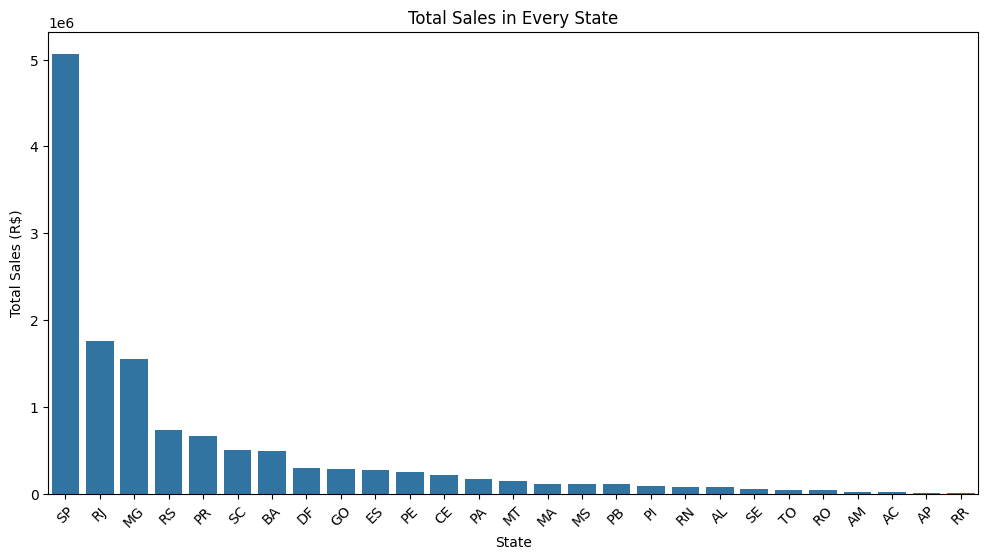

In [22]:
# Find top spender by state and total sales by state

# Merge the order, order_item, and customer datasets
state_df = order.merge(order_item, on='order_id', how='left').merge(cust, on='customer_id', how='left')

# Group by state and calculate total sales and number of orders
state_sales = state_df.groupby('customer_state').agg({
    'price': 'sum',
    'order_id': 'nunique'
}).reset_index()

# Rename columns for clarity
state_sales.columns = ['State', 'Total Sales', 'Number of Orders']

# Sort by total sales in descending order
state_sales = state_sales.sort_values('Total Sales', ascending=False)

# Calculate average order value
state_sales['Average Order Value'] = state_sales['Total Sales'] / state_sales['Number of Orders']

# Display the top states by total sales
print("States by Total Sales:")
print(state_sales)

# Visualize the top 10 states by total sales
plt.figure(figsize=(12, 6))
sns.barplot(x='State', y='Total Sales', data=state_sales)
plt.title('Total Sales in Every State')
plt.xlabel('State')
plt.ylabel('Total Sales (R$)')
plt.xticks(rotation=45)
plt.show()


Average Customer Spending by State:
   customer_state       price
14             PB  192.127679
1              AL  184.673817
0              AC  175.065604
20             RO  167.336117
13             PA  165.531869
3              AP  165.121111
16             PI  161.990440
19             RN  157.592438
26             TO  156.137129
5              CE  154.107560
21             RR  153.423261
24             SE  150.864507
12             MT  146.761446
9              MA  146.261725
15             PE  144.266604
11             MS  142.330419
2              AM  135.925399
4              BA  134.016872
6              DF  125.901660
18             RJ  124.418388
8              GO  124.214625
23             SC  123.754790
7              ES  120.738629
10             MG  120.191362
22             RS  118.819252
17             PR  117.908216
25             SP  109.092928


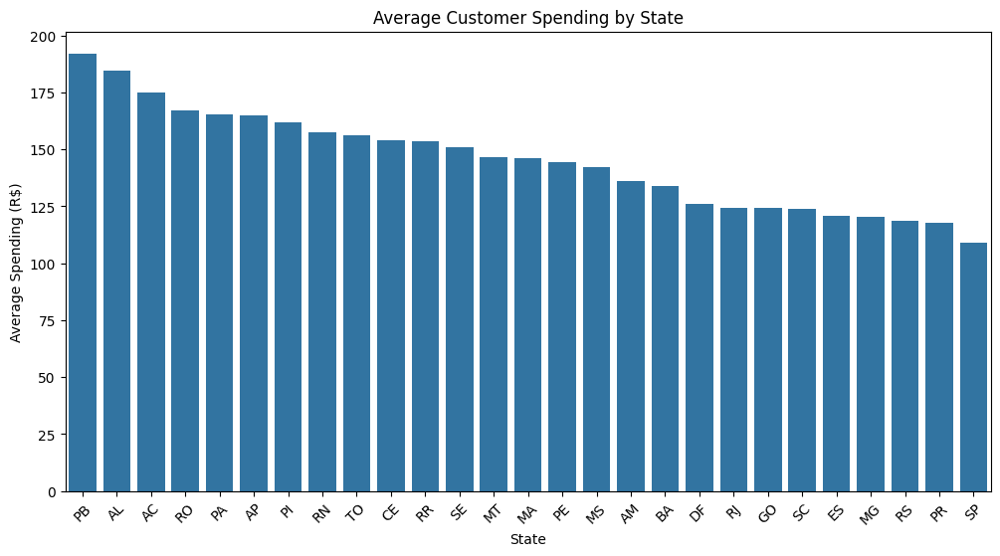

In [23]:
# Find the average customer spending by state
avg_spending_by_state = state_df.groupby('customer_state').agg({
    'price': 'mean'
}).reset_index()

avg_spending_by_state = avg_spending_by_state.sort_values('price', ascending=False)

print("\nAverage Customer Spending by State:")
print(avg_spending_by_state)

#Bar chart of average customer spending by state
plt.figure(figsize=(12, 6))
sns.barplot(x='customer_state', y='price', data=avg_spending_by_state)
plt.title('Average Customer Spending by State')
plt.xlabel('State')
plt.ylabel('Average Spending (R$)')
plt.xticks(rotation=45)
plt.show()

In [24]:
# Merge customer data with order data
customer_order_df = pd.merge(cust, order, on='customer_id')

# Merge with order items data to get product information
customer_order_product_df = pd.merge(customer_order_df, order_item, on='order_id')

# Group by customer state and product category, then count unique orders
state_product_counts = customer_order_product_df.groupby(['customer_state', 'product_id']).agg({
    'order_id': 'nunique',
    'price': 'mean'
}).reset_index()


# Merge product categories with state_product_counts
state_product_counts = pd.merge(state_product_counts, product[['product_id', 'product_category_name']], on='product_id')

# Merge with product category translation
state_product_counts = pd.merge(state_product_counts, product_categories, on='product_category_name', how='left')

# Get the top product category for each state
top_categories_by_state = state_product_counts.loc[state_product_counts.groupby('customer_state')['order_id'].idxmax()]

# Sort by number of orders
top_categories_by_state = top_categories_by_state.sort_values('order_id', ascending=False)

# Display the results
print("Top Product Categories by State:")
print(top_categories_by_state[['customer_state', 'product_category_name_english', 'order_id', 'price']])

Top Product Categories by State:
      customer_state product_category_name_english  order_id       price
51353             SP                bed_bath_table       215   87.888407
31358             RJ         computers_accessories        88  143.708191
15726             MG         computers_accessories        78  135.739878
36002             RS               furniture_decor        33   70.815385
1298              BA         computers_accessories        21  149.900000
22460             PR                  garden_tools        20   54.925926
37885             SC                  garden_tools        19   56.259259
3973              CE                 health_beauty        17  327.619048
8684              GO               furniture_decor        15   71.033333
4778              DF                 health_beauty        14   84.990000
7326              ES         computers_accessories        12  141.912500
19661             PB                 health_beauty        11  328.181818
20342             

## Visualization & Explanatory Analysis

### Question 1: How can we segment our customers based on their purchasing behavior to target marketing efforts more effectively

#### Customer Segmentation Using RFM Analysis
We calculated Recency, Frequency, and Monetary values for each customer and assigned RFM scores based on quartiles. The RFM scores were combined to create customer segments, and the distribution of these segments was visualized using a pie chart.

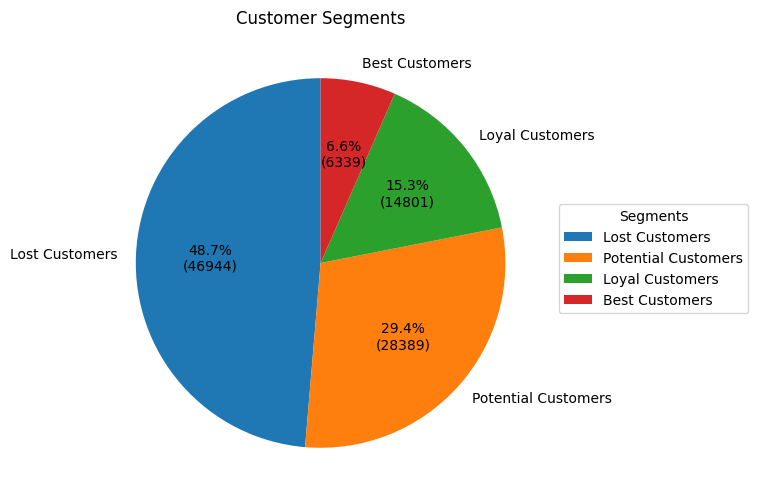

In [25]:
# Visualize the segments using a pie chart
segment_counts = rfm_df['rfm_segment'].value_counts()
plt.figure(figsize=(10, 6))
plt.pie(segment_counts, labels=segment_counts.index, autopct=lambda p: f'{p:.1f}%\n({int(p*sum(segment_counts)/100)})', startangle=90)
plt.title('Customer Segments')
plt.legend(title="Segments", loc="center left", bbox_to_anchor=(1, 0.01, 0.5, 1))
plt.show()

### Question 2: How are our customers distributed geographically, and are there any regional trends in purchasing behavior?

#### Geospatial Analysis
In this section, we perform geospatial analysis to understand the geographical distribution of our customers and identify any regional trends in purchasing behavior.

The resulting dataset provides insights into customer distribution and purchasing behavior across different regions.


In [32]:
# Merge datasets on zip code prefix with only necessary columns
merged_data = pd.merge(
    cust[['customer_zip_code_prefix', 'customer_city', 'customer_state']],
    geolocation[['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng']],
    left_on='customer_zip_code_prefix',
    right_on='geolocation_zip_code_prefix',
    how='inner'
)

# Remove duplicate zip codes from the geolocation dataset
geolocation_unique = geolocation.drop_duplicates(subset=['geolocation_zip_code_prefix'])

# Now merge datasets on zip code prefix with only necessary columns
merged_data = pd.merge(
    cust[['customer_zip_code_prefix', 'customer_city', 'customer_state']],
    geolocation_unique[['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng']],
    left_on='customer_zip_code_prefix',
    right_on='geolocation_zip_code_prefix',
    how='inner'
)

# Drop rows with NaN values in latitude or longitude
merged_data = merged_data.dropna(subset=['geolocation_lat', 'geolocation_lng'])

# Check the number of data points after the correction
num_datapoints = len(merged_data)
print(f"Number of datapoints after correcting the merge: {num_datapoints}")

Number of datapoints after correcting the merge: 99163


In [35]:
#Showing the map
locations = list(zip(merged_data['geolocation_lat'], merged_data['geolocation_lng']))

# Create a map centered on Brazil
m = folium.Map(location=[-14.235, -51.925], zoom_start=4)

# Use FastMarkerCluster for large datasets
MarkerCluster(locations).add_to(m)

# Display the map
m

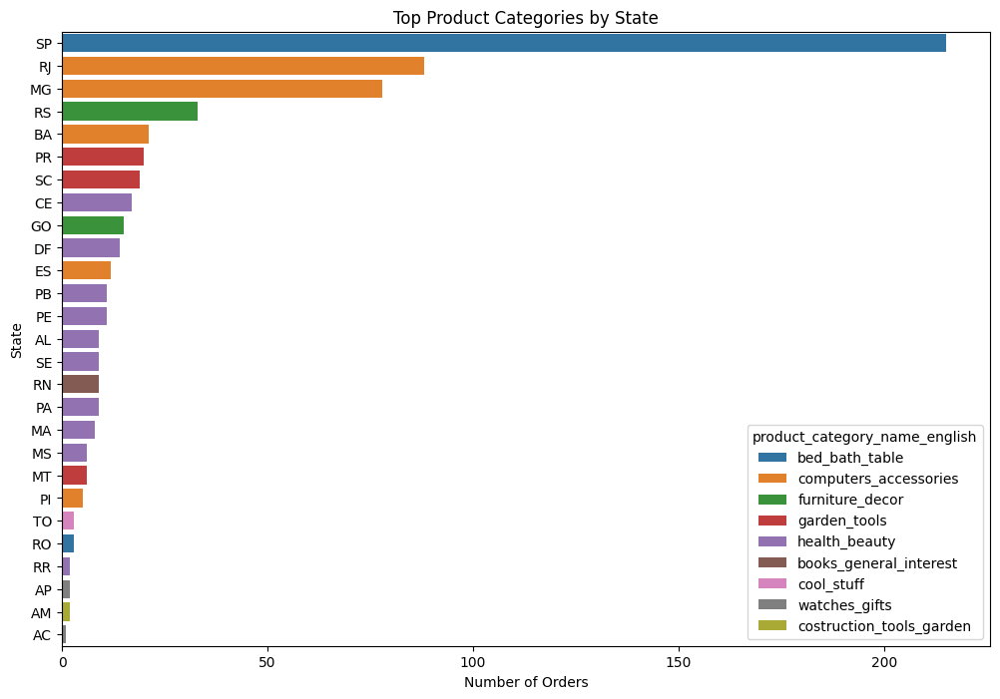

In [36]:
#Visualize top product categories by state
plt.figure(figsize=(12, 8))
sns.barplot(data=top_categories_by_state, x='order_id', y='customer_state', hue='product_category_name_english')
plt.title('Top Product Categories by State')
plt.xlabel('Number of Orders')
plt.ylabel('State')
plt.show()

C:\Users\Fathur\AppData\Local\Temp\ipykernel_20768\3085959681.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=shipping_times_by_state, x='customer_state', y='avg_shipping_time', palette='Blues_d')


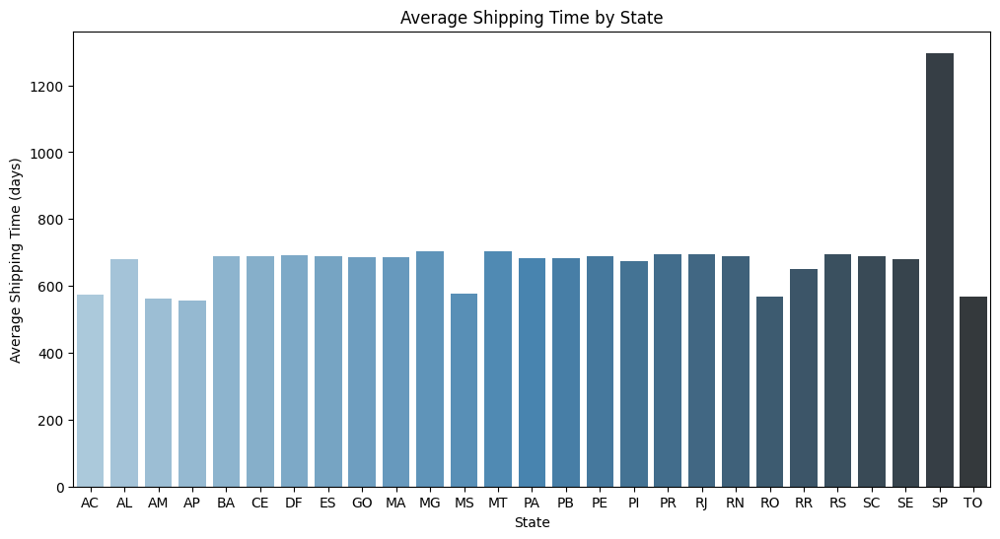

In [46]:
# Ensure that shipping_limit_date is in datetime format
order_item['shipping_limit_date'] = pd.to_datetime(order_item['shipping_limit_date'])

# Merge order_item with order to get customer_id
merged_with_orders = order_item.merge(order[['order_id', 'customer_id']], on='order_id', how='inner')

# Now merge with the cust dataset
merged_data = merged_with_orders.merge(cust[['customer_id', 'customer_state']], on='customer_id', how='inner')

# Group by customer_state and calculate the mean shipping limit date (average shipping time)
shipping_times_by_state = merged_data.groupby('customer_state')['shipping_limit_date'].apply(lambda x: (x.max() - x.min()).days).reset_index()

# Rename columns for clarity
shipping_times_by_state.columns = ['customer_state', 'avg_shipping_time']

# Plot shipping times by state
plt.figure(figsize=(12, 6))
sns.barplot(data=shipping_times_by_state, x='customer_state', y='avg_shipping_time', palette='Blues_d')
plt.title('Average Shipping Time by State')
plt.xlabel('State')
plt.ylabel('Average Shipping Time (days)')
plt.show()

In [49]:
#combine all datasets into one
combined_df = pd.concat([
    cust, 
    order,
    order_item,
    order_reviews,
    order_payments,
    product,
    product_categories,
    seller,
    geolocation
], ignore_index=True)

# Save the combined DataFrame to a CSV file
combined_df.to_csv('main_data.csv', index=False)

print("Combined dataset has been saved as 'main_data.csv'")

Combined dataset has been saved as 'main_data.csv'


## Conclusion

### Conclusion for question 1: How can we segment our customers based on their purchasing behavior to target marketing efforts more effectively?
Based on the RFM (Recency, Frequency, Monetary) analysis of customer purchasing behavior, we can conclude:

1. Customers are segmented into five distinct groups, with varying degrees of engagement and purchasing power, allowing for tailored marketing strategies.
2. High-value customers (RFM scores of 5) represent a significant portion of the total customer base, indicating the importance of loyalty programs and exclusive offers to retain this segment.
3. There is a noticeable drop in engagement among customers with lower RFM scores, suggesting a need for targeted re-engagement campaigns to boost their purchasing frequency.

### Conclusion for question 2: How are our customers distributed geographically, and are there any regional trends in purchasing behavior?
Regarding the geographic distribution and purchasing trends of our customers, we can conclude:

1. The majority of sales are concentrated in the state of São Paulo (SP), highlighting a key market for future marketing efforts and product availability.
2. States like Rio de Janeiro (RJ) and Minas Gerais (MG) also show significant sales figures, suggesting potential for targeted marketing strategies in these regions.
3. The average order value varies by state, with notable high spending in states such as Paraíba (PB) and Alagoas (AL), indicating regional preferences that can inform product promotions.

Based on these findings, there are several strategies that can be implemented for further performance enhancement, including:

1. Developing personalized marketing campaigns aimed at high-value customer segments identified in the RFM analysis.
2. Expanding product offerings and targeted promotions in key geographic markets like SP, RJ, and MG to capitalize on high sales potential.
3. Utilizing regional purchasing trends to tailor inventory and marketing strategies, ensuring alignment with customer preferences in different states.
